In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import anndata
import matplotlib.pyplot as plt
import numpy as np
import pooch
from scipy.sparse import csr_matrix
from scipy.io import mmwrite


In [2]:
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(10, 10))
sc.settings.verbosity = 3


In [7]:

results_file = 'smaple1.h5ad'
adata = sc.read_10x_mtx(
'data/BC21/', var_names="gene_symbols", cache=True)



... writing an h5ad cache file to speedup reading next time


In [8]:
# 消除重复的列
adata.var_names_make_unique()



In [9]:
adata


AnnData object with n_obs × n_vars = 6580 × 32864
    var: 'gene_ids', 'feature_types'

normalizing counts per cell
    finished (0:00:00)


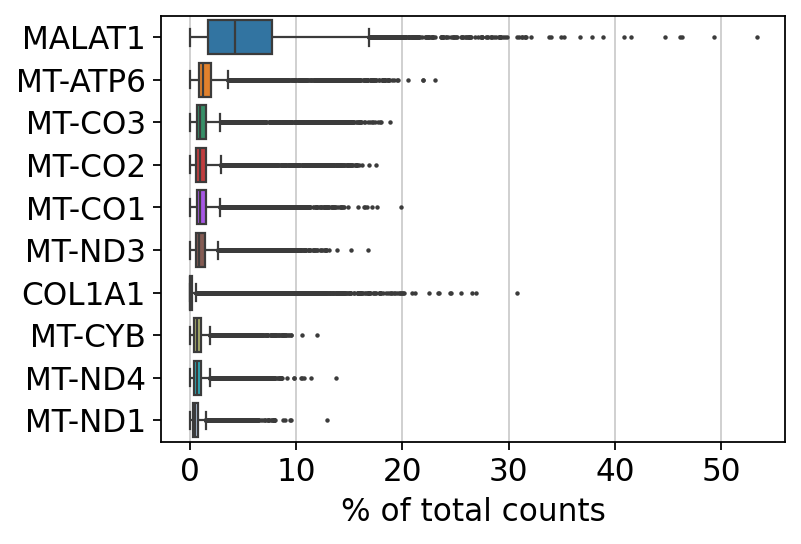

filtered out 83 cells that have less than 200 genes expressed
filtered out 12575 genes that are detected in less than 3 cells


In [10]:
sc.pl.highest_expr_genes(adata, n_top=10)

sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)



In [11]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')
adata.var['mt']

# 计算指标, qc的var选择 var.mt
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], 
    percent_top=None, log1p=False, inplace=True)



In [12]:
adata.obs



,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
AAACCCAAGAGATGCC-1,954,954,2570.0,129.0,5.019455
AAACCCAAGCCTCTCT-1,691,691,1215.0,84.0,6.913580
AAACCCAAGCGCTTCG-1,3512,3509,10485.0,755.0,7.200763
AAACCCAGTCACTCGG-1,3973,3972,15725.0,601.0,3.821940
AAACCCAGTGGCTAGA-1,1616,1616,7569.0,1259.0,16.633636
...,...,...,...,...,...
TTTGTTGCAAAGACGC-1,4628,4628,24584.0,1129.0,4.592418
TTTGTTGCAGACTCTA-1,1238,1238,3154.0,134.0,4.248573
TTTGTTGGTATCACCA-1,2531,2530,6794.0,287.0,4.224316
TTTGTTGTCGTTGTGA-1,3164,3164,13813.0,783.0,5.668573


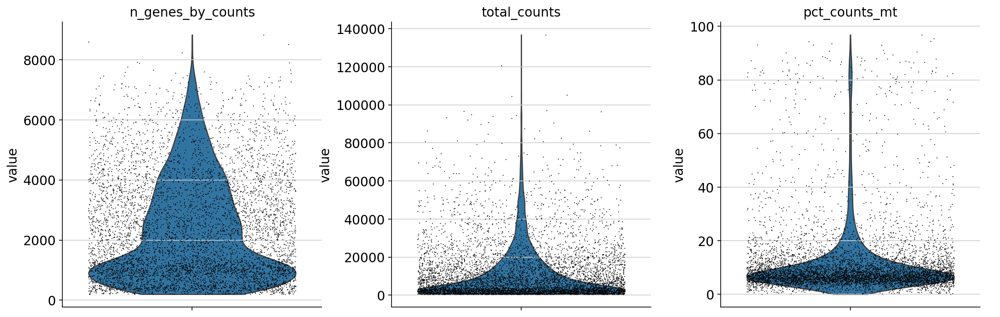

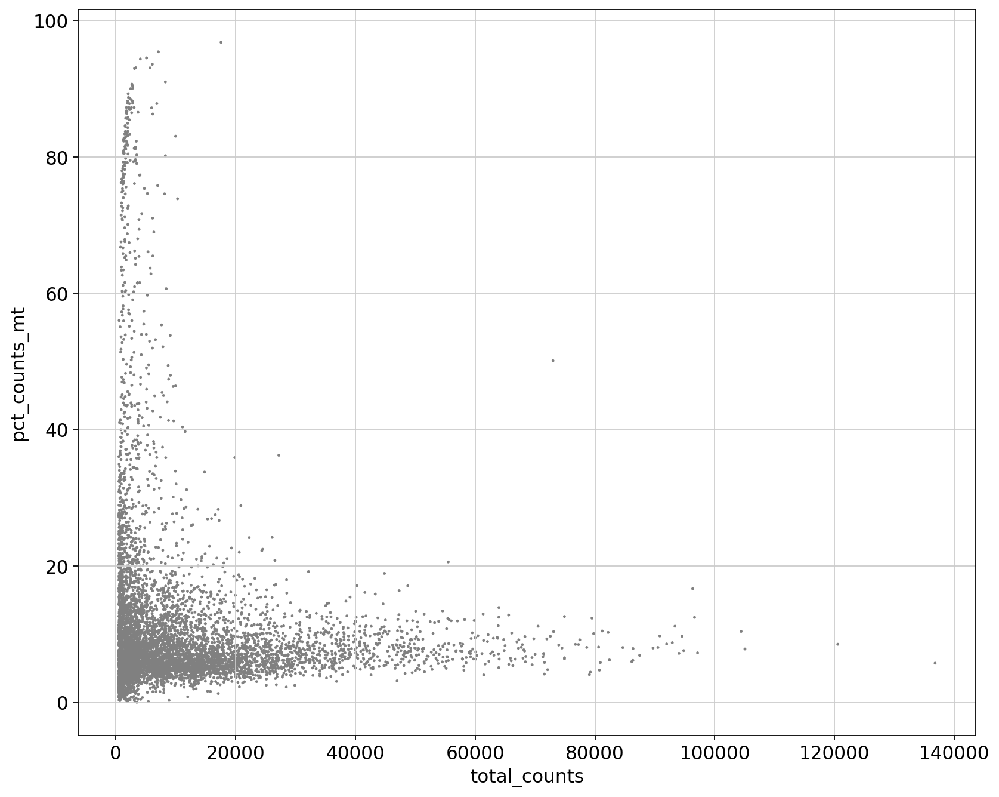

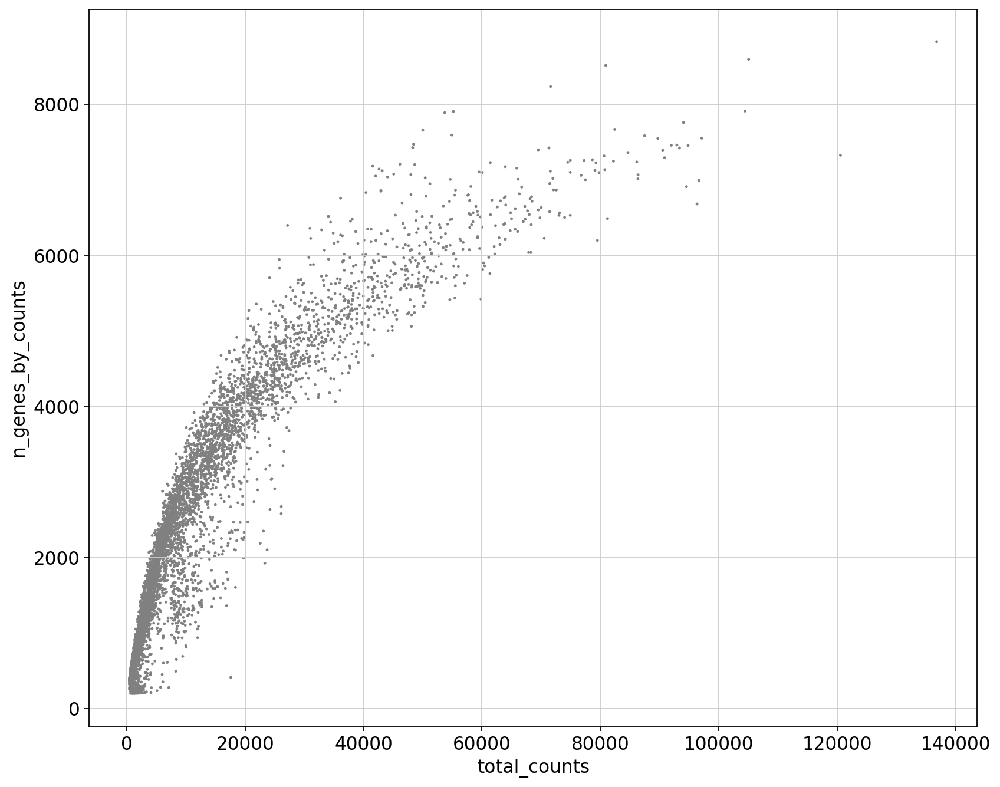

In [13]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')



In [14]:
adata = adata[adata.obs.n_genes_by_counts > 500, :]
adata = adata[adata.obs.pct_counts_mt < 20, :]

adata



View of AnnData object with n_obs × n_vars = 5384 × 20289
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [15]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.X




/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 14220348 stored elements and shape (5384, 20289)>

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


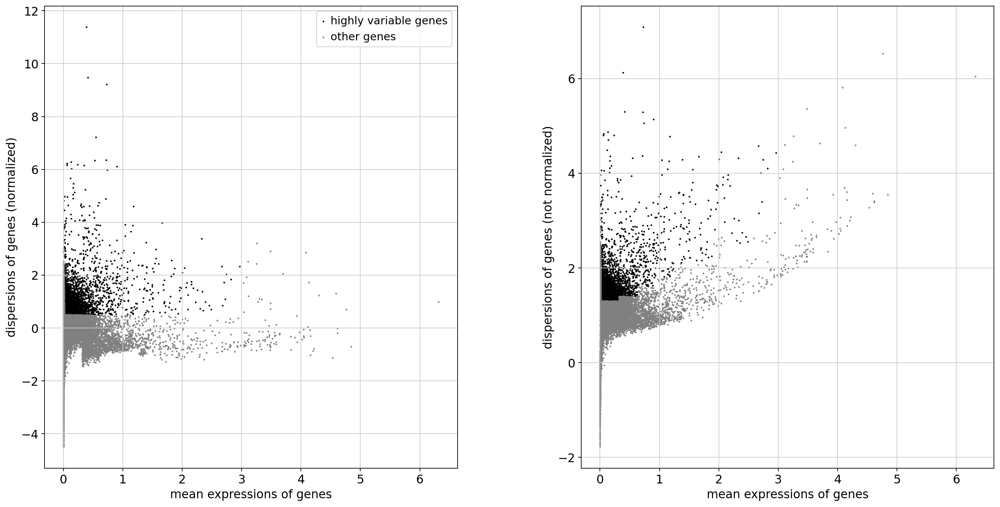

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:728: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:00)


AnnData object with n_obs × n_vars = 5384 × 3972
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

In [16]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)
adata
adata.raw = adata

adata = adata[:, adata.var.highly_variable]
adata

sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata, max_value=10)
adata



computing PCA
    with n_comps=50
    finished (0:00:02)


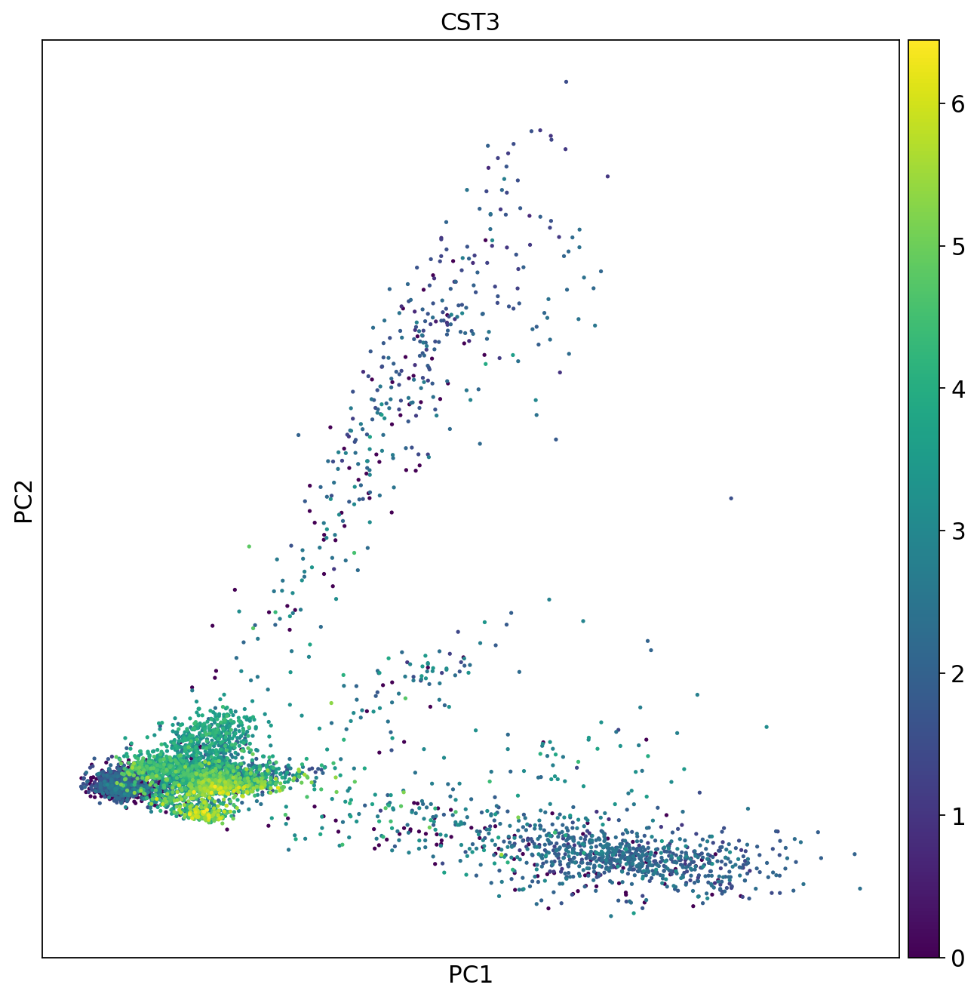

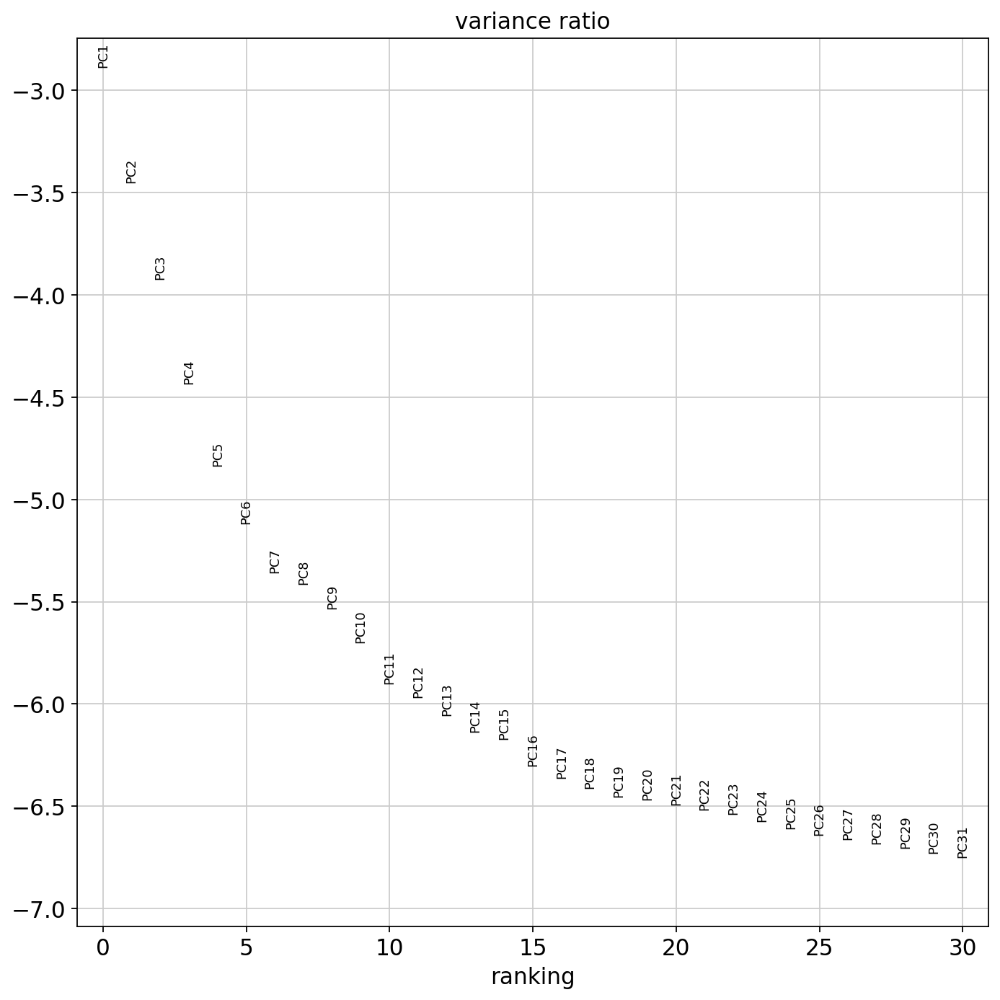

computing neighbors
    using 'X_pca' with n_pcs = 40


2026-01-22 18:13:17.281927: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2026-01-22 18:13:17.788001: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)


AnnData object with n_obs × n_vars = 5384 × 3972
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [17]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca(adata, color='CST3')
sc.pl.pca_variance_ratio(adata, log=True)
adata.write(results_file)
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
adata



computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:07)


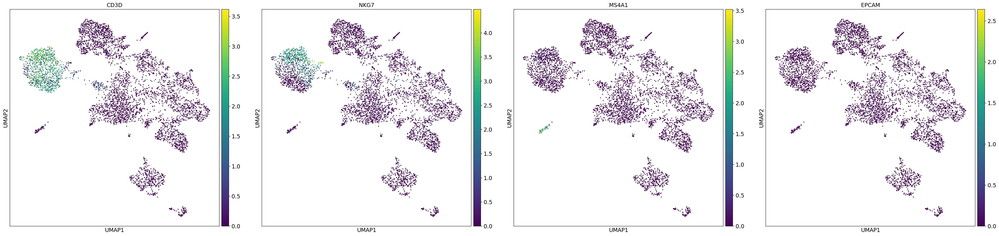

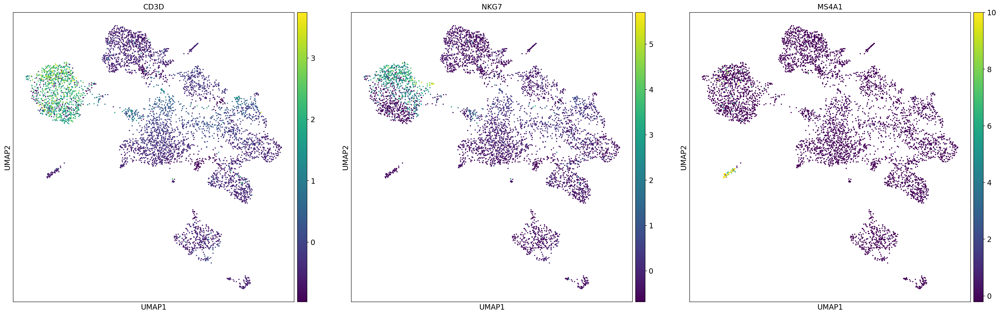

running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/tmp/ipykernel_6444/165426720.py:4: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata)


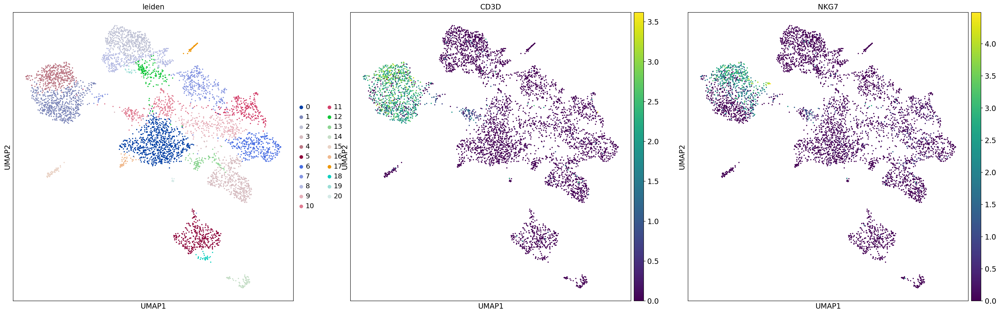

In [18]:
sc.tl.umap(adata)
sc.pl.umap(adata, color=['CD3D', 'NKG7', 'MS4A1','EPCAM'])
sc.pl.umap(adata, color=['CD3D', 'NKG7', 'MS4A1'], use_raw=False)
sc.tl.leiden(adata)
sc.pl.umap(adata, color=['leiden', 'CD3D', 'NKG7'])
adata.write(results_file)



ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:

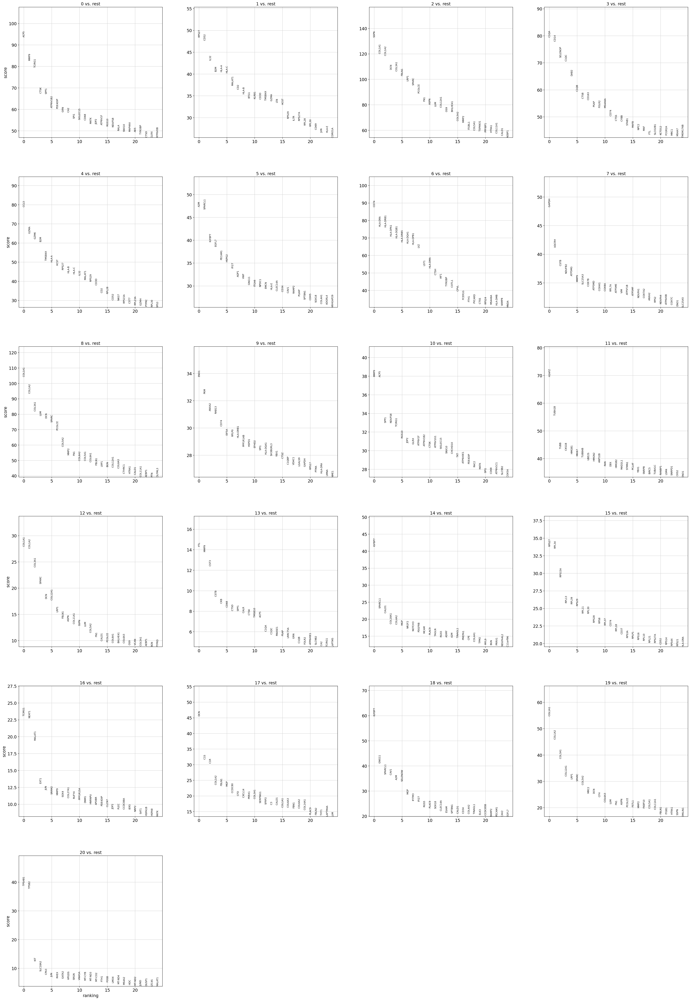

In [19]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)



ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:

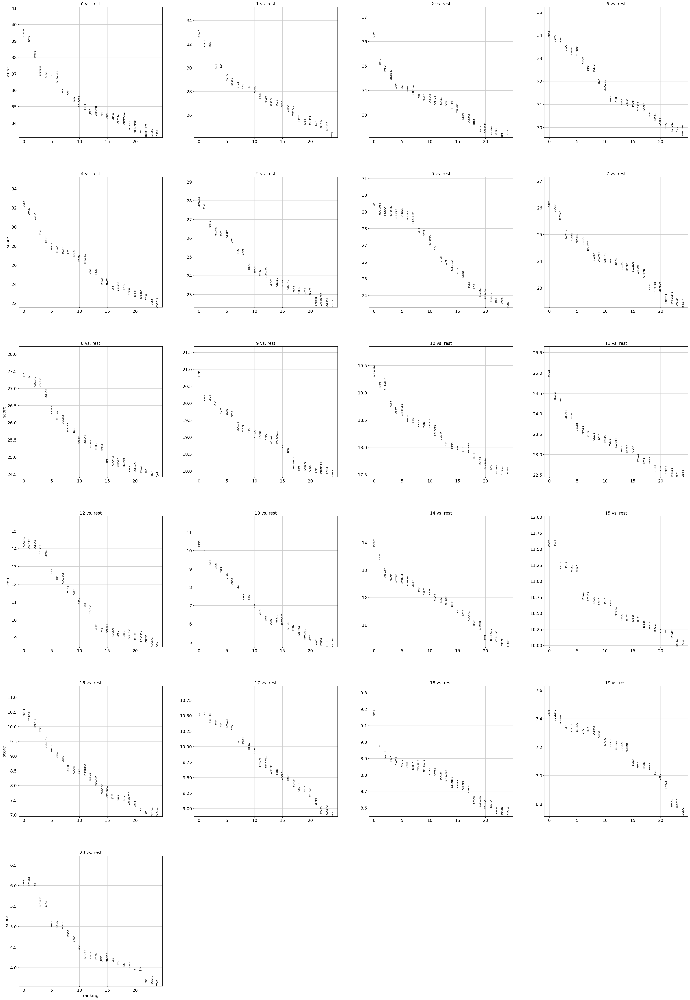

In [20]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
adata.write(results_file)



ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:47)


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:406: ConvergenceWarning: lbfgs failed to converge after 100 iteration(s) (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT

Increase the number of iterations to improve the convergence (max_iter=100).
You might also want to scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


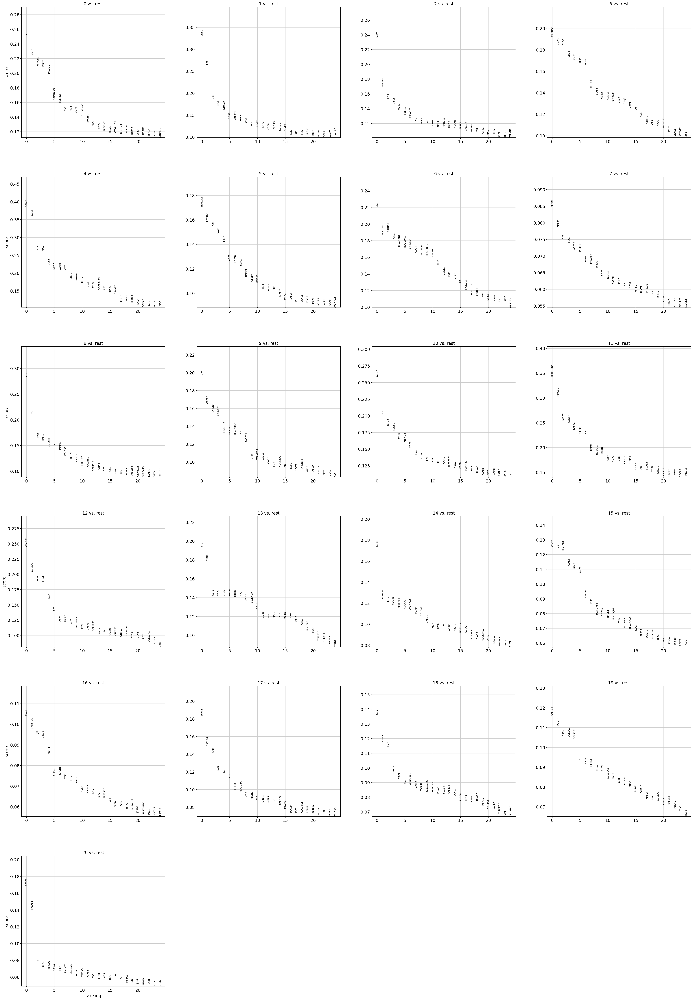

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)




In [22]:
adata = sc.read(results_file)

pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)




,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,TCIRG1,RPS27,SSPN,CD14,CCL5,SPARCL1,LYZ,GAPDH,PTN,PTMA,...,MKI67,COL3A1,MMP9,IGFBP7,CD37,NEAT1,C1R,RGS5,MRC2,TPSB2
1,ACP5,CD52,LRP1,C1QA,GZMK,A2M,HLA-DRB1,UQCRH,LUM,RPLP0,...,H2AFZ,COL1A2,FTL,COL18A1,RPL34,TCIRG1,DCN,CAV1,COL12A1,TPSAB1
2,MMP9,B2M,FBLN1,DAB2,GZMA,EGFL7,HLA-DQB1,ATP5MG,COL1A1,NPM1,...,BIRC5,COL1A1,CSTB,COL4A2,RPL13,MALAT1,CCDC80,TINAGL1,FKBP10,KIT
3,PDE4DIP,IL32,BHLHE41,C1QC,B2M,PECAM1,HLA-DPB1,COX4I1,COL3A1,YBX1,...,NUSAP1,COL12A1,CALR,MCAM,RPL39,EXT1,MGP,IFI27,CFH,SLC18A2
4,CTSK,HLA-C,ASPN,CD163,HCST,HSPG2,HLA-DRA,NDUFA4,COL1A2,NME1,...,CENPF,SPARC,CST3,NOTCH3,RPL11,COL27A1,C1S,GNG11,COL1A1,CPA3


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:

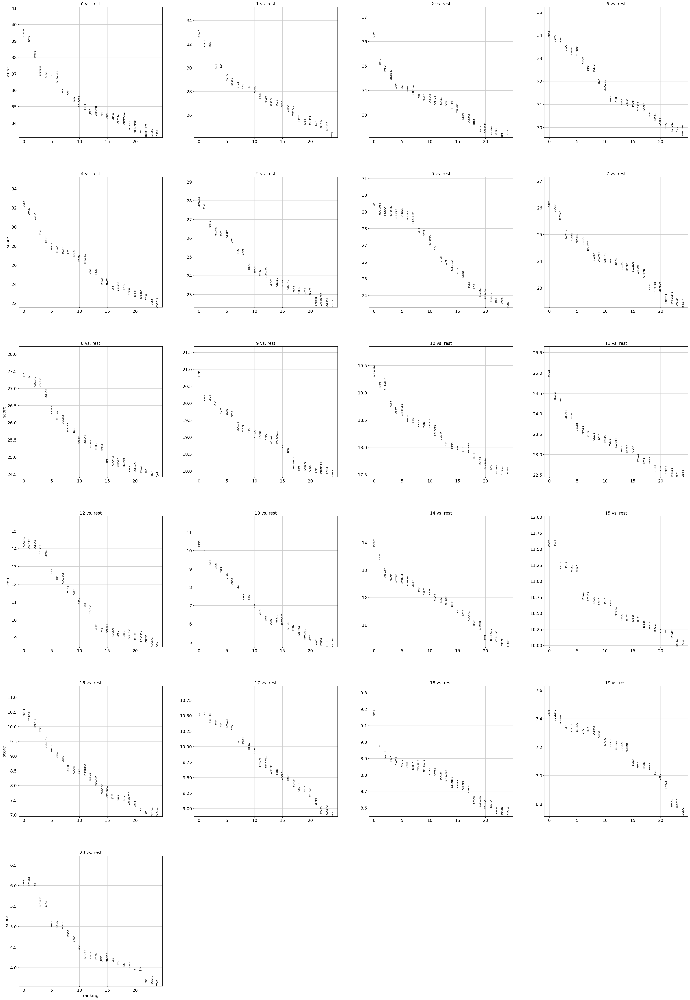

In [23]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


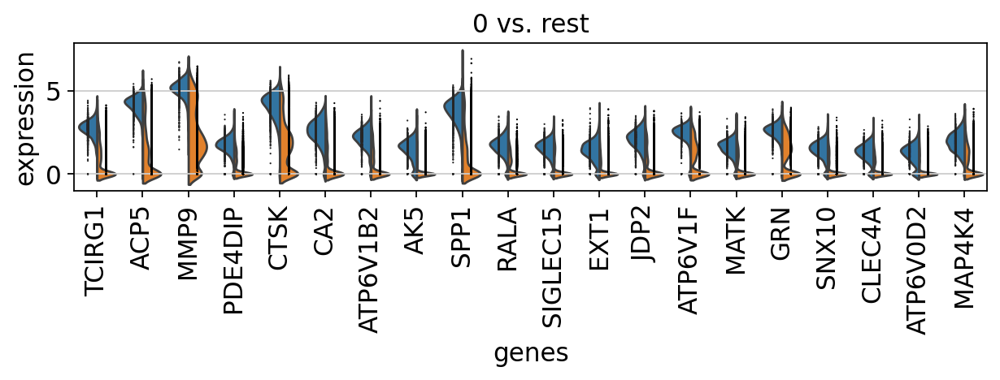

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


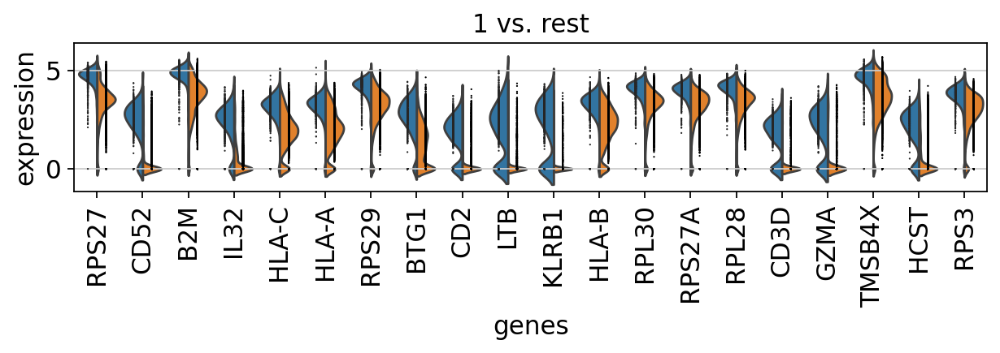

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


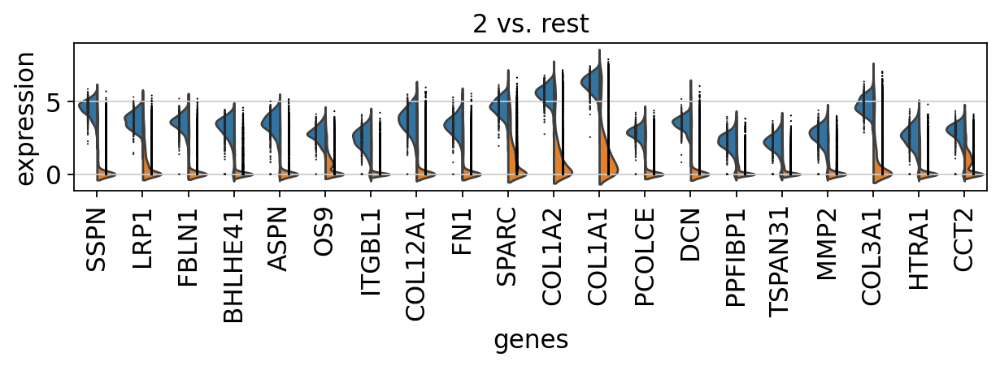

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


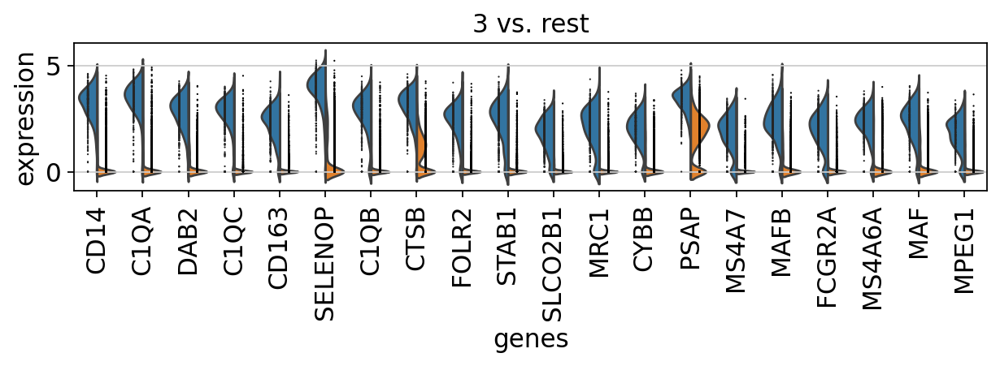

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


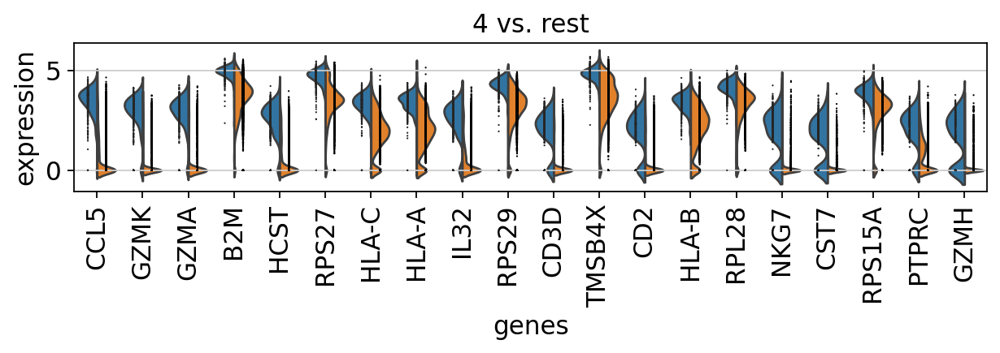

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


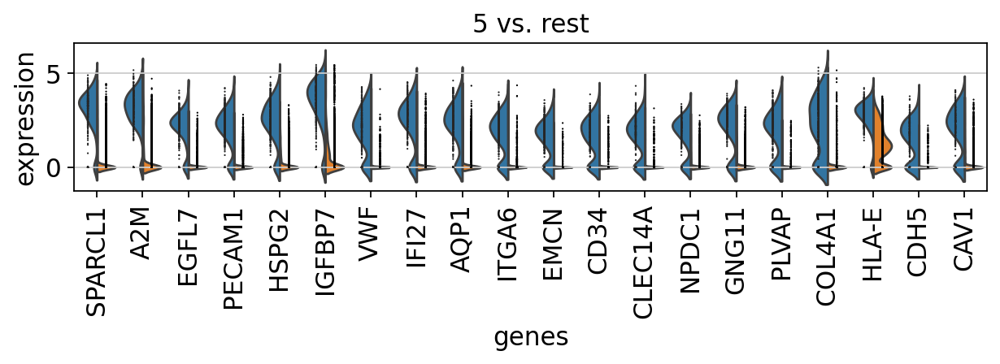

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


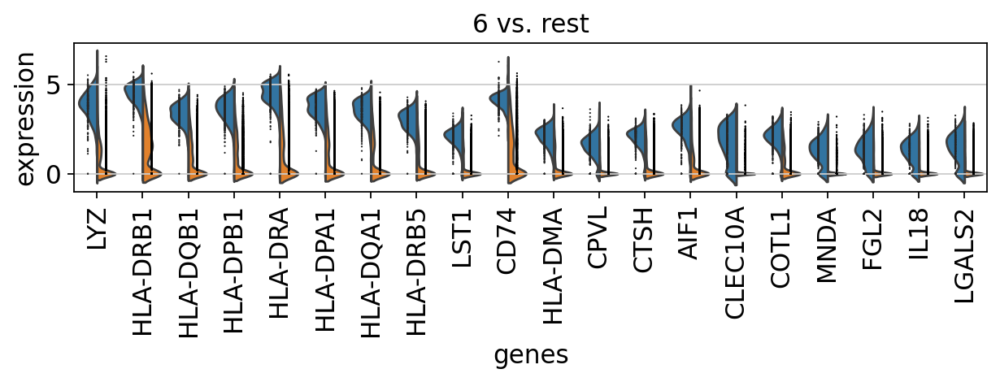

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


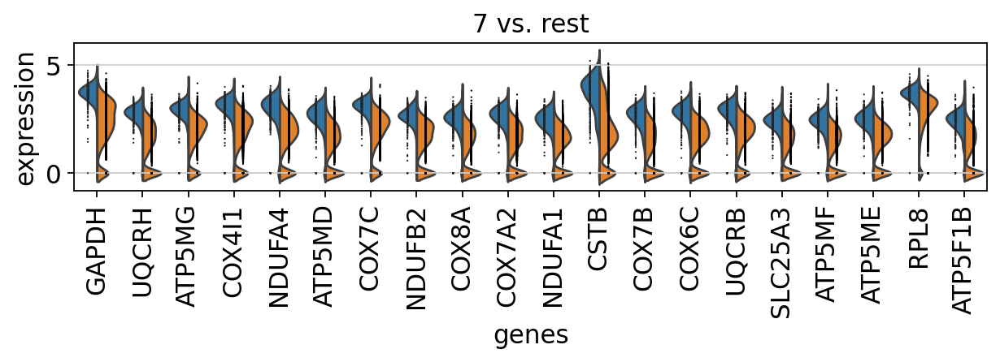

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


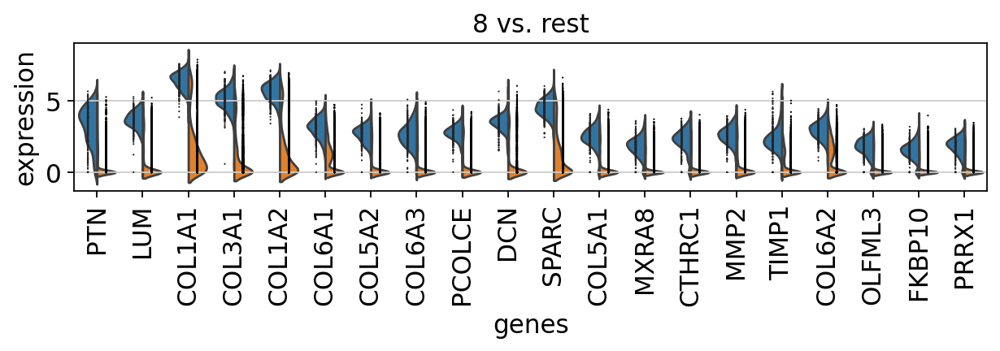

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


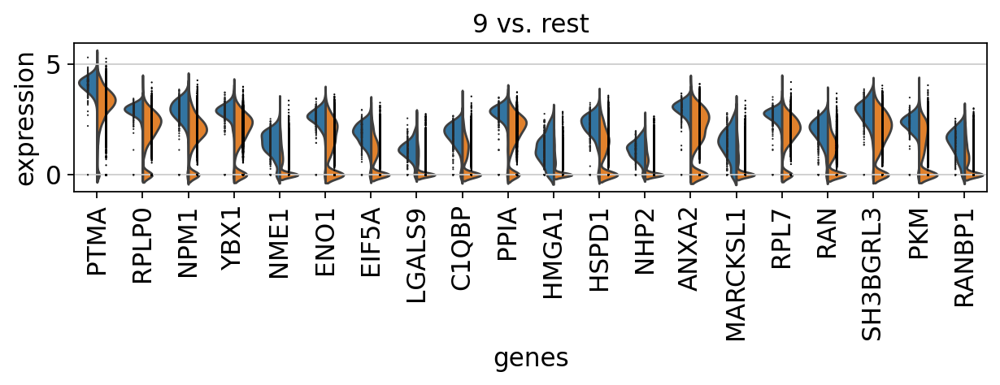

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


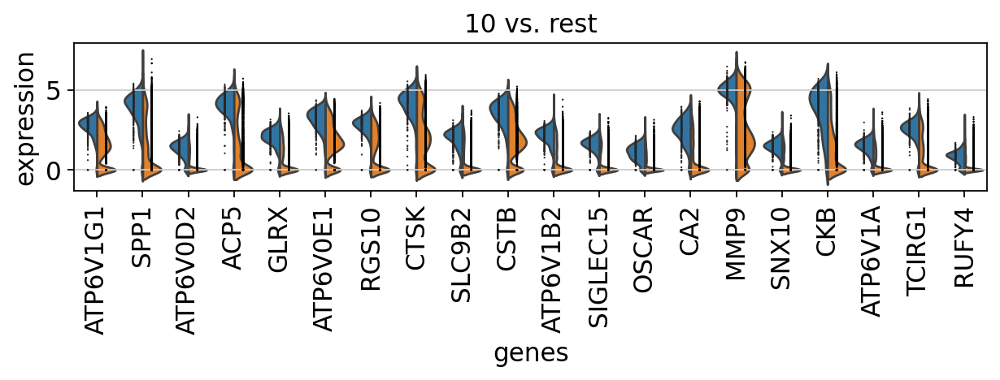

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


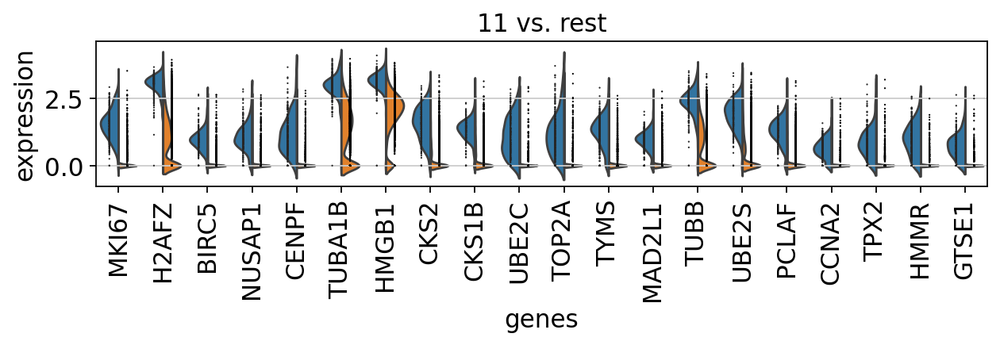

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


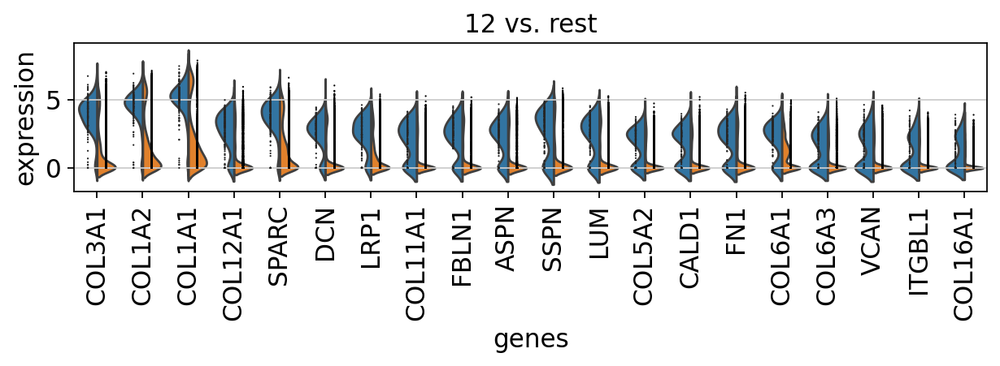

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


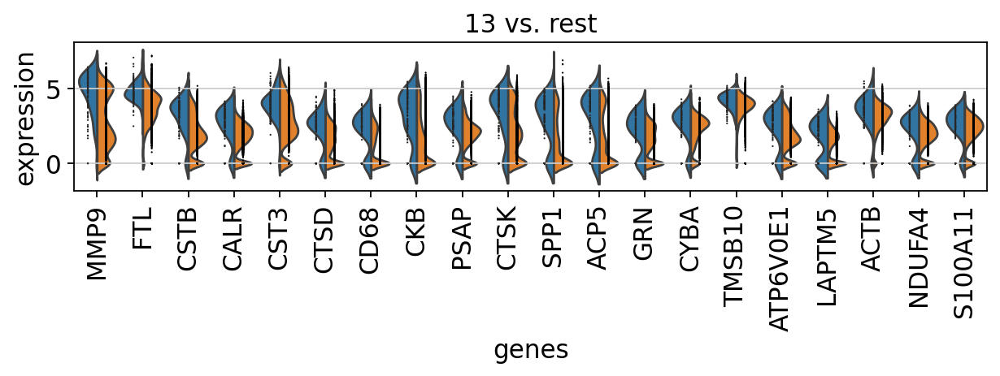

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


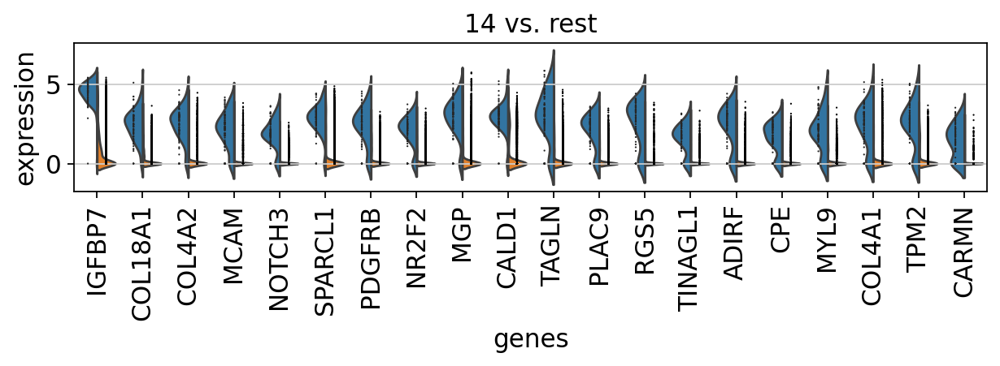

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


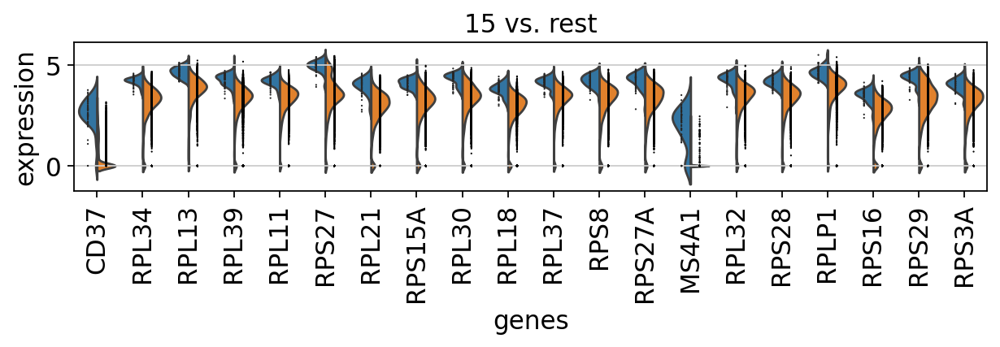

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


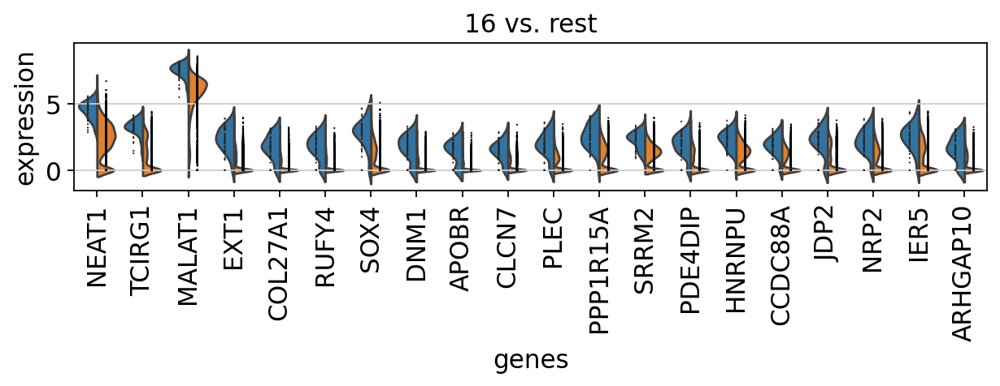

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


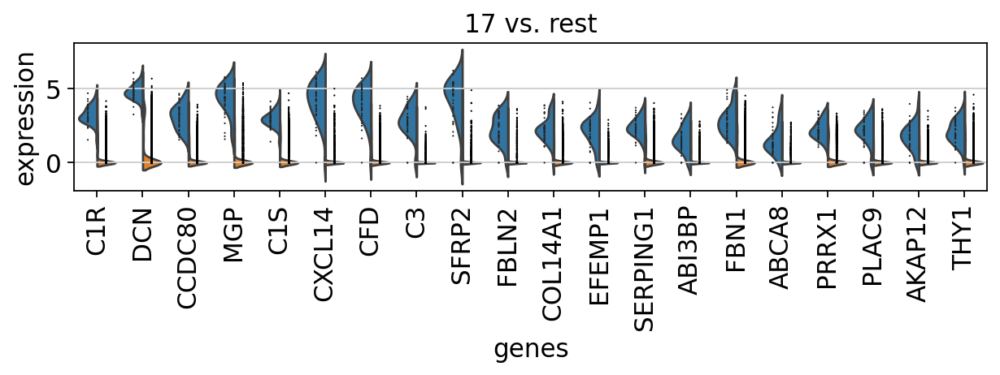

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


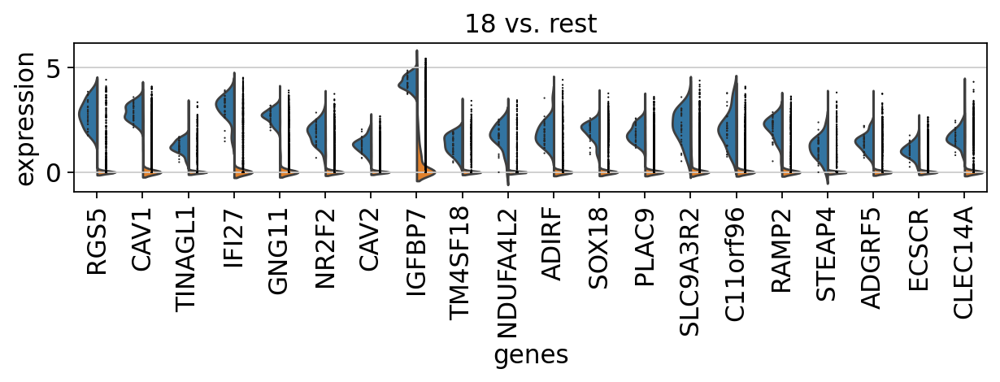

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


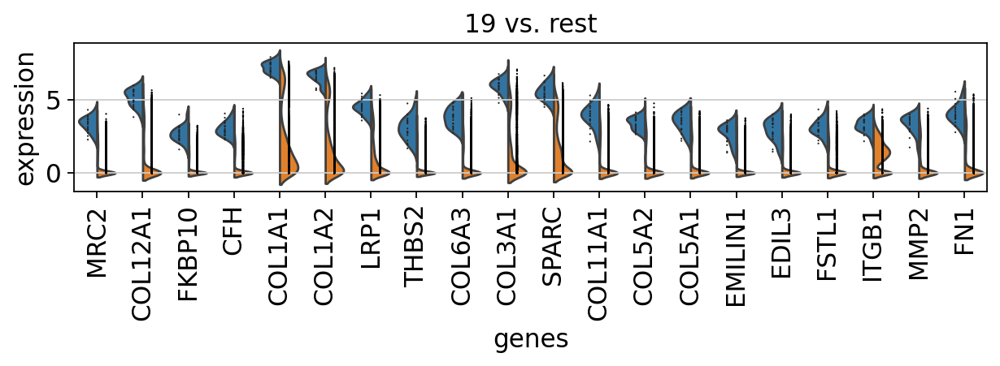

/home/dongfang/miniforge3/envs/bioinfo/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


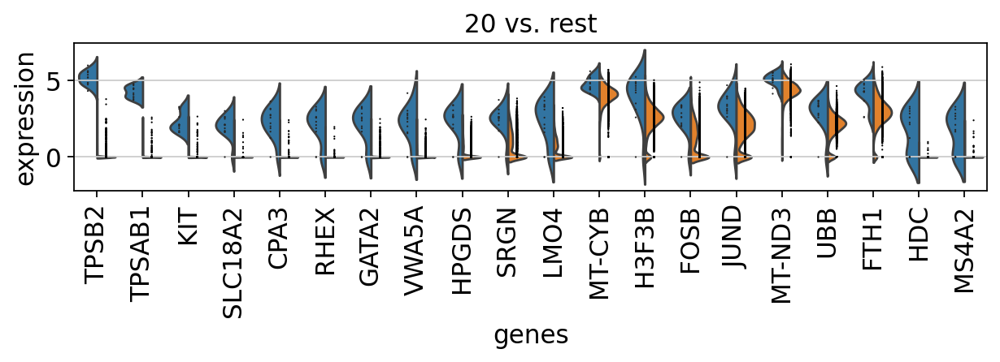

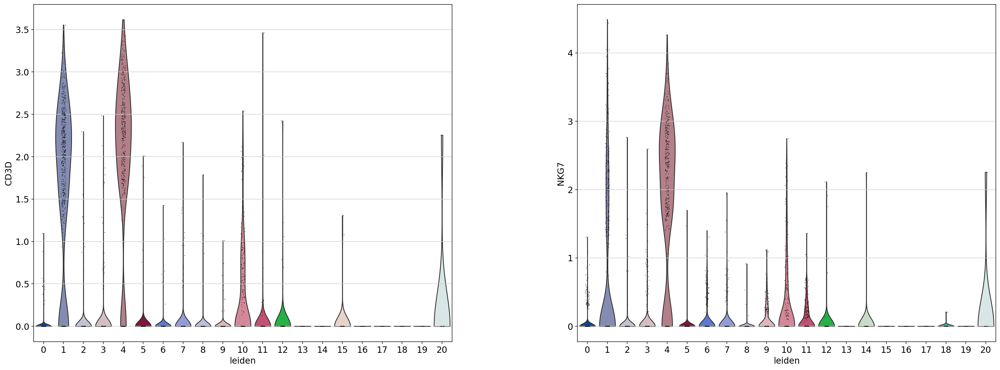

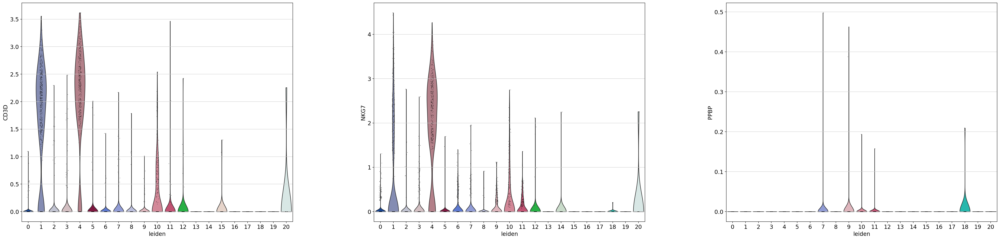

In [24]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
for group in groups for key in ['names', 'pvals']}).head(5)

from matplotlib.pyplot import rc_context

with rc_context({'figure.figsize': (9, 1.5)}):
    sc.pl.rank_genes_groups_violin(adata, n_genes=20, jitter=False)


sc.pl.violin(adata, ['CD3D', 'NKG7' ], groupby='leiden')
sc.pl.violin(adata, ['CD3D', 'NKG7', 'PPBP'], groupby='leiden')



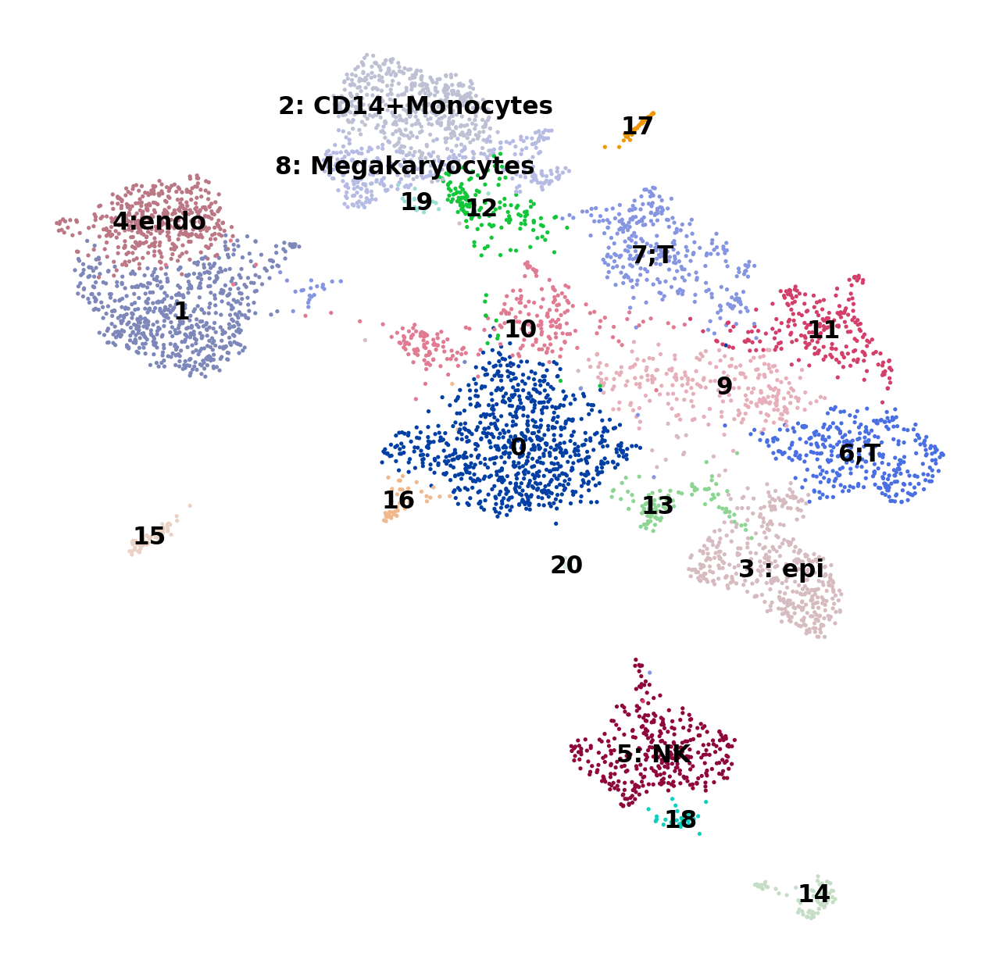

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


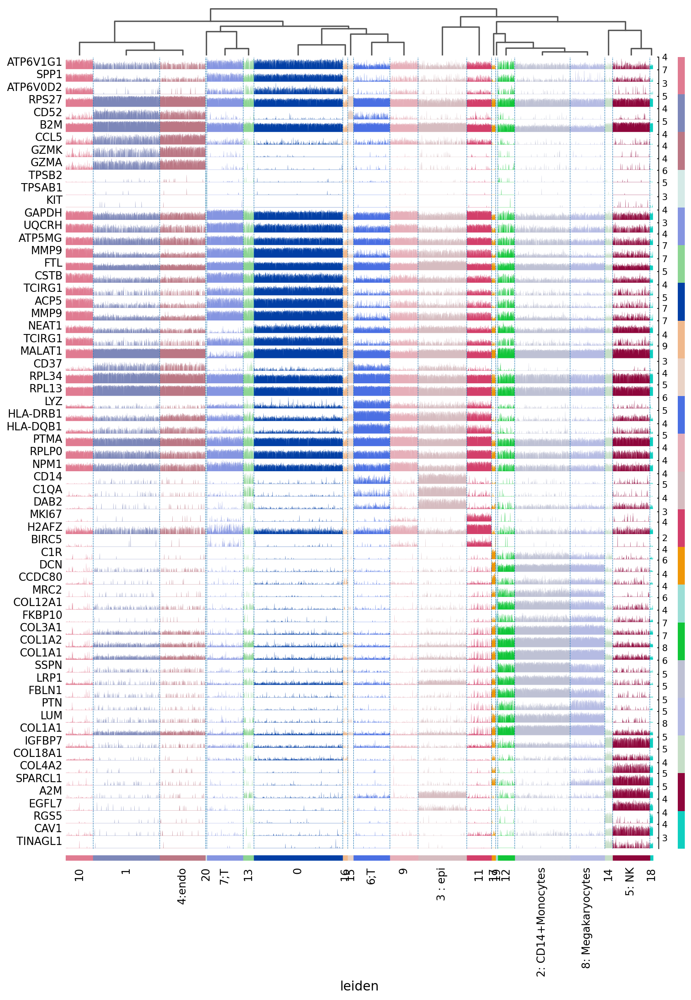

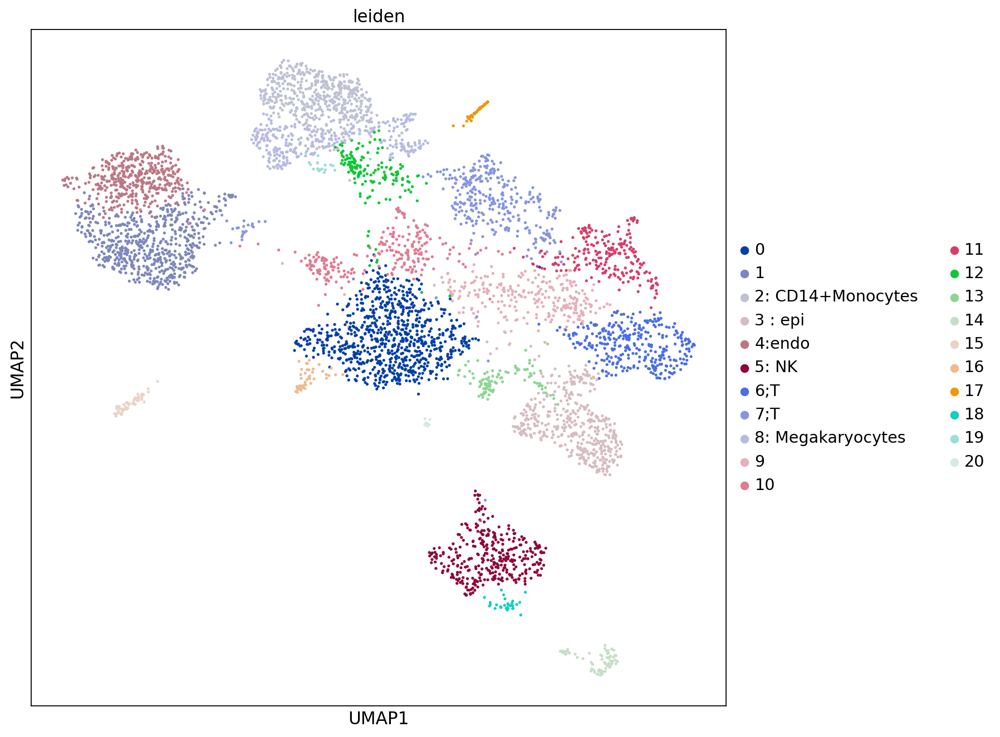

In [26]:
new_cluster_names = [
'0', '1', '2: CD14+Monocytes','3 : epi', '4:endo',
'5: NK', '6;T', '7;T', '8: Megakaryocytes','9',
'10','11','12','13','14','15','16','17','18',
'19','20']
adata.rename_categories('leiden', new_cluster_names)

sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False)

sc.pl.rank_genes_groups_tracksplot(adata, n_genes=3)


sc.pl.umap(adata, color=['leiden' ])